## Advanced Lane Finding

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Configuration

### Imports

In [1]:
import glob
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np

# Libraries to edit/save/watch video clips
from IPython.display import HTML
from moviepy.editor import ImageSequenceClip
from moviepy.editor import VideoFileClip

#Camera Calibration with OpenCV
import image

#Lane Finding 
import lane

### Loading test images as list of  `Lane` objects

In [2]:
test_images = sorted(glob.glob('test_images/*.jpg'))

lanes_list = []
for imgpath in test_images:
    lanes_list.append(lane.Lane(imgpath=imgpath))

### Perspective transform constants

In [3]:
print('img_size = {0}\n'.format(lane.img_size))
print('     src = [{0}]\n'.format('\n            '.join(['[ ' + ', '.join(['{0:4d}'.format(int(r)) for r in row]) + ' ]' for row in lane.src])))
print('     src = [{0}]\n'.format('\n            '.join(['[ ' + ', '.join(['{0:4d}'.format(int(r)) for r in row]) + ' ]' for row in lane.dst])))

img_size = (1280, 720)

     src = [[  595,  450 ]
            [  685,  450 ]
            [ 1000,  660 ]
            [  280,  660 ]]

     src = [[  300,    0 ]
            [  980,    0 ]
            [  980,  720 ]
            [  300,  720 ]]



### Parameters for finding the lane lines

In [4]:
# window settings
window_width = 50 # width of the convolution windows --> must be even!
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin_naive = 50 # How much to slide left and right for searching
margin_prior = 50
minsum = 3

assert window_width % 2 == 0, '`window_width` must be even'

## 1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

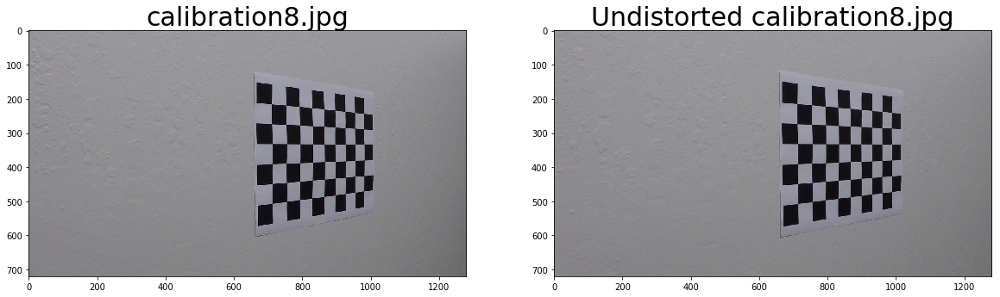

In [5]:
calibration_images = sorted(glob.glob('camera_cal/*.jpg'))
nx = 9
ny = 6

mtx, dist = image.calibrate_camera(calibration_images, nx, ny)

l = lane.Lane(imgpath='camera_cal/calibration8.jpg')
undistorted = l.get_undistorted(mtx, dist, outfile='output_images/undistorted_calibration8.jpg')
image.show_images(l.img, 'calibration8.jpg', undistorted, 'Undistorted calibration8.jpg')

## 2. Apply a distortion correction to raw images.

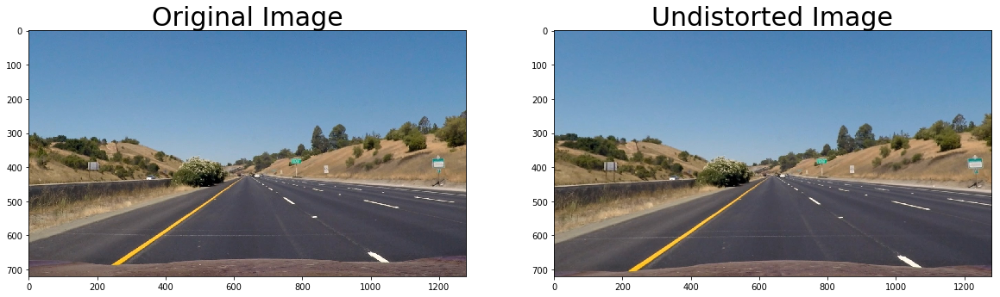

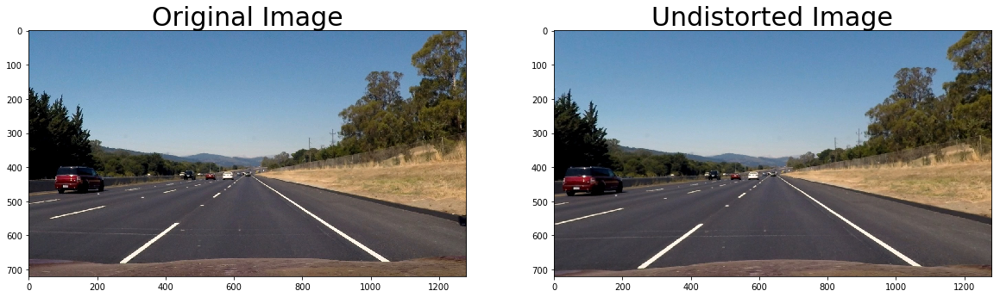

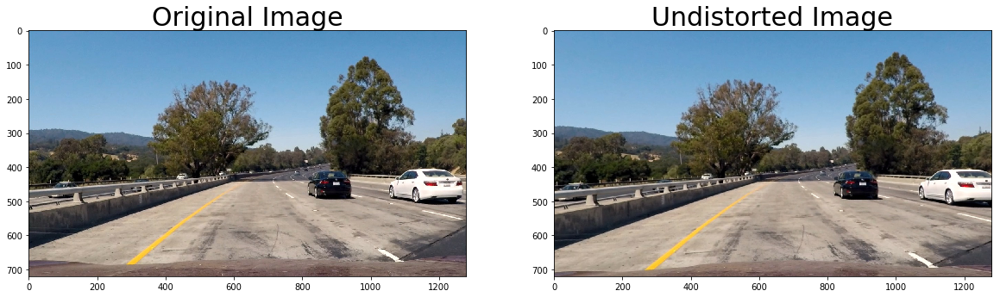

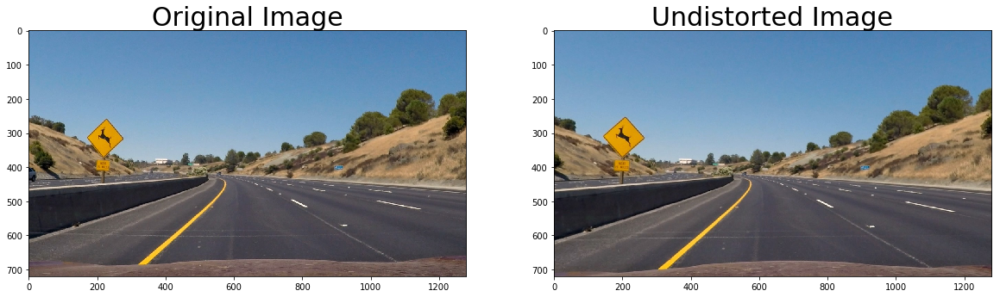

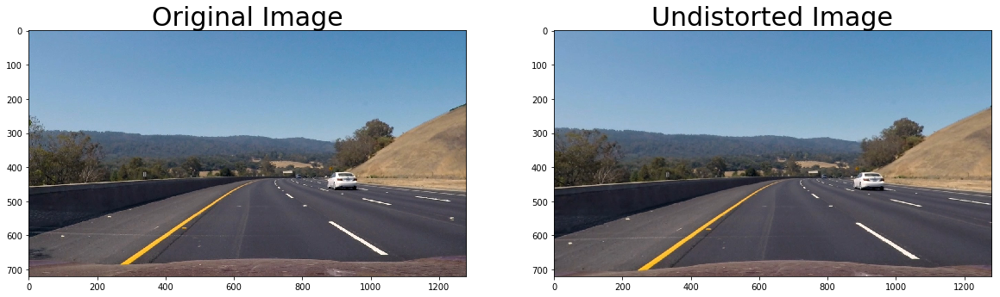

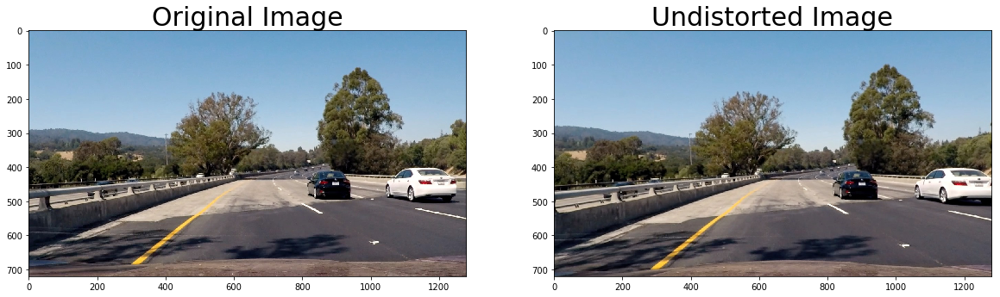

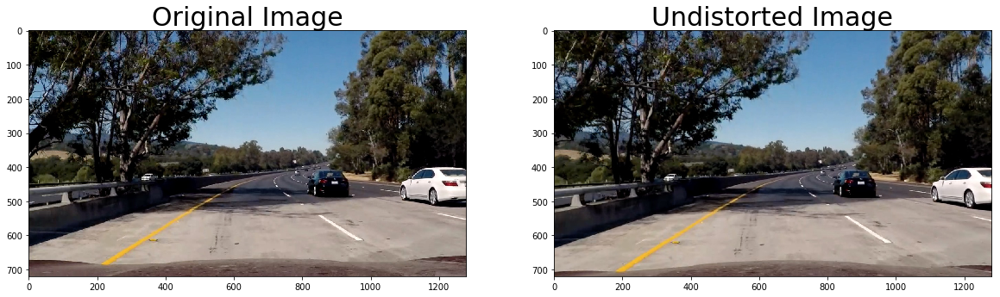

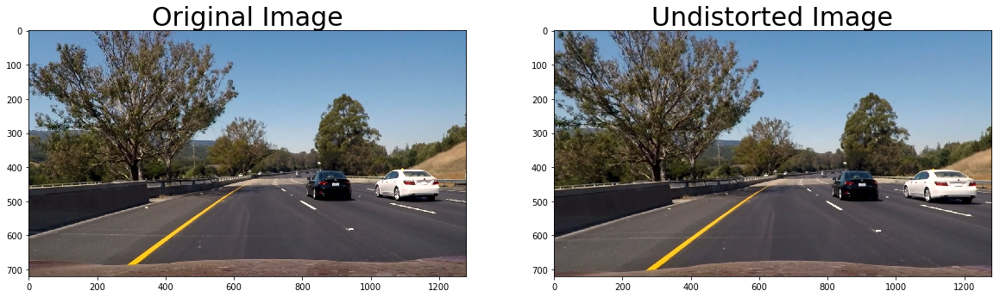

In [6]:
outfile = 'output_images/undistorted/undistorted_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist, outfile=outfile.format(os.path.basename(l.imgpath)))    
    image.show_images(l.img, 'Original Image', undistorted, 'Undistorted Image')

## 3. Use color transforms, gradients, etc., to create a thresholded binary image.

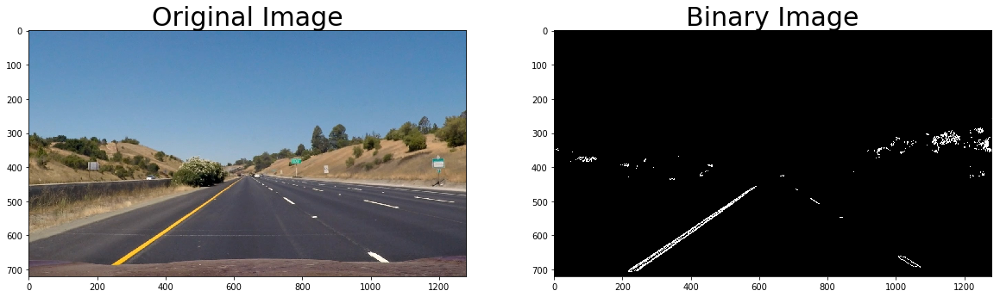

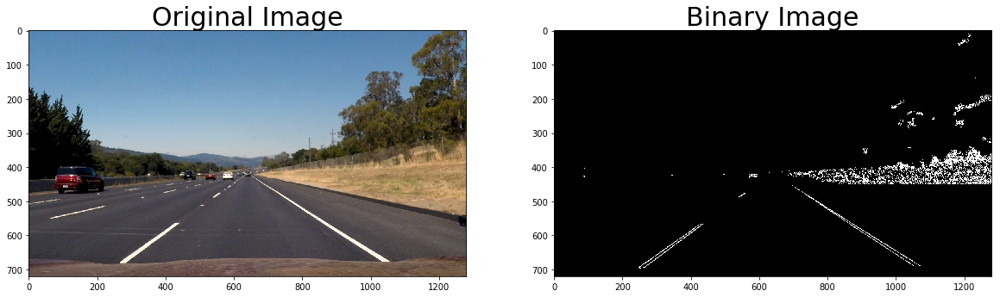

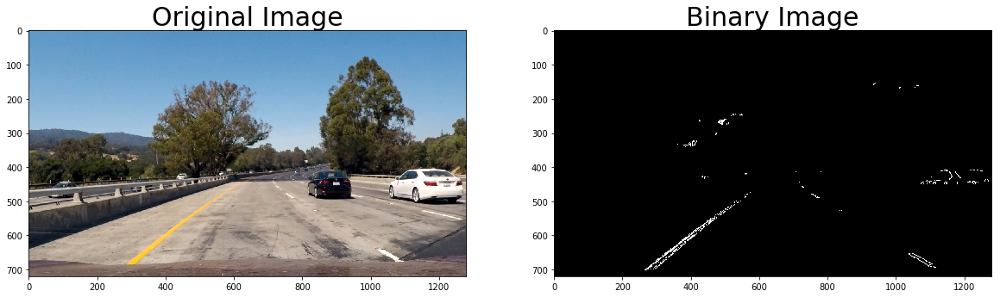

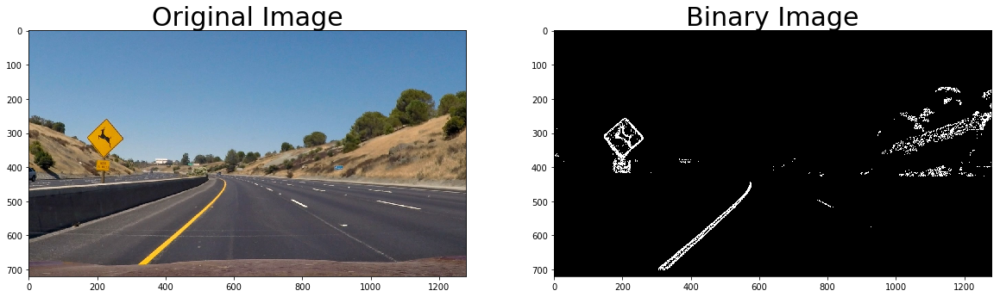

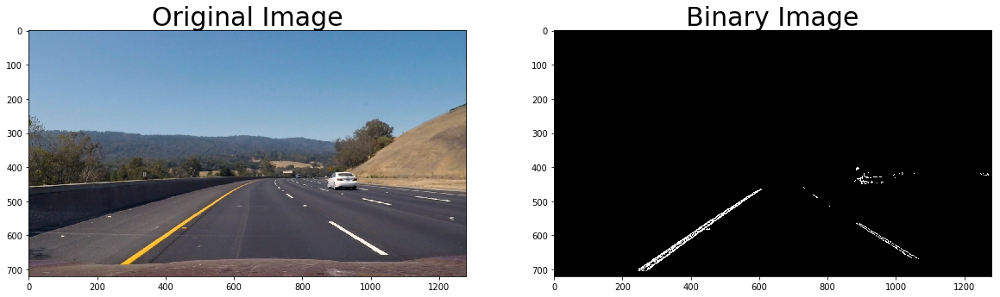

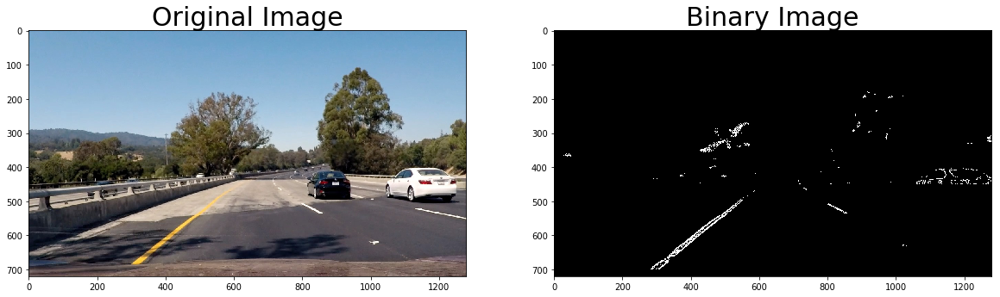

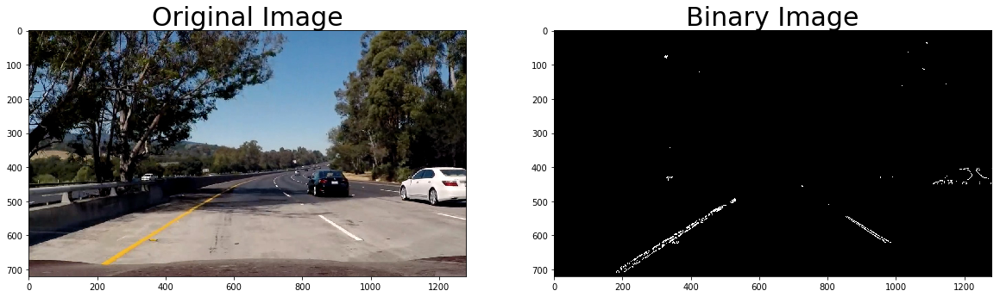

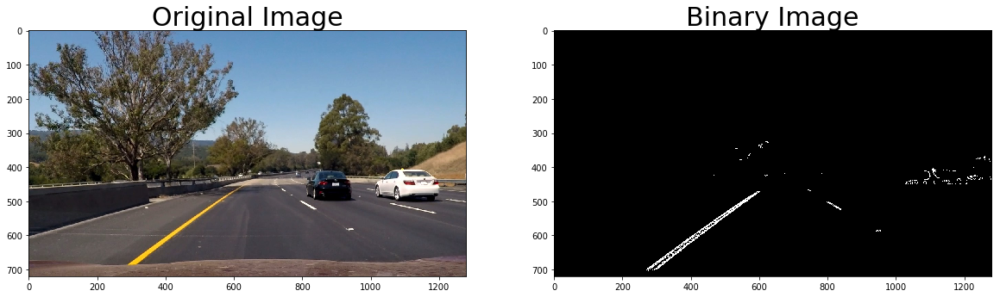

In [7]:
outfile = 'output_images/binary/binary_{0}'
for l in lanes_list:
    binary = l.get_binary(mtx, dist, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(l.img, 'Original Image', binary*255, 'Binary Image')

## 4. Apply a perspective transform to rectify binary image ("birds-eye view").

### Display the perspective images

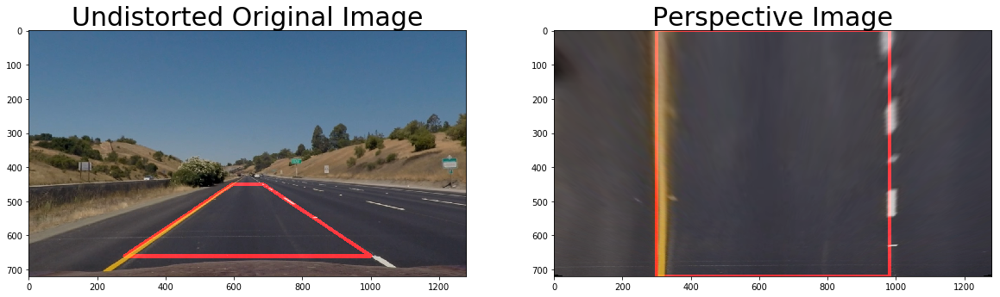

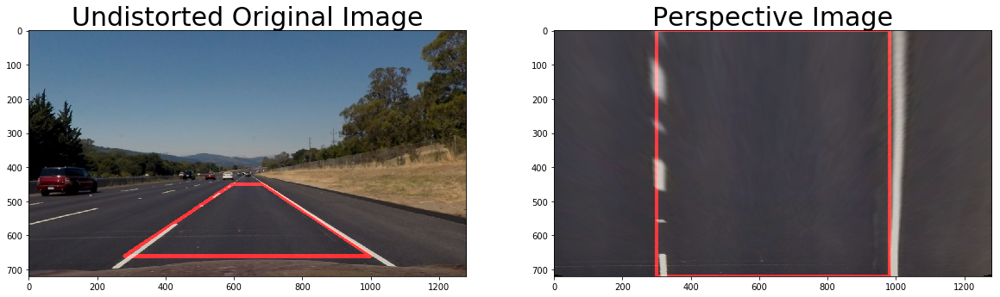

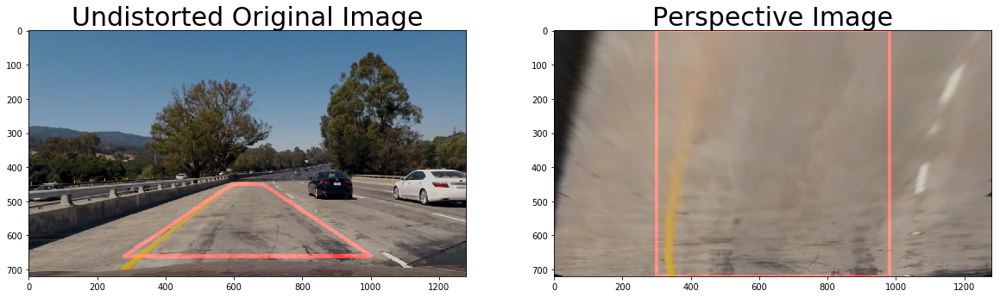

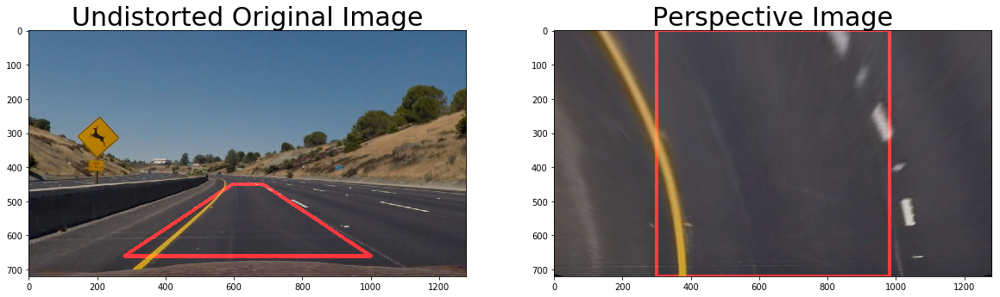

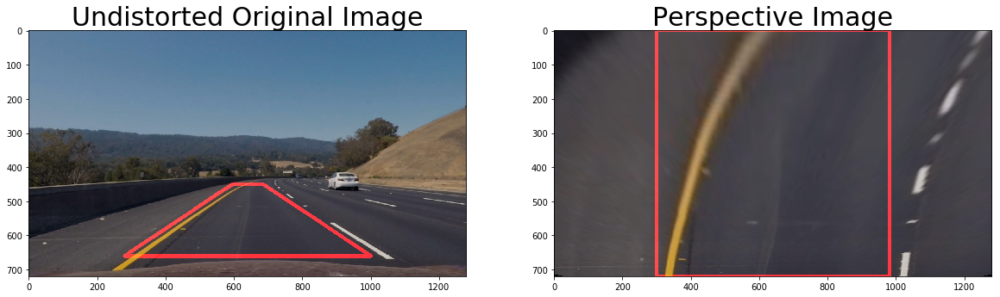

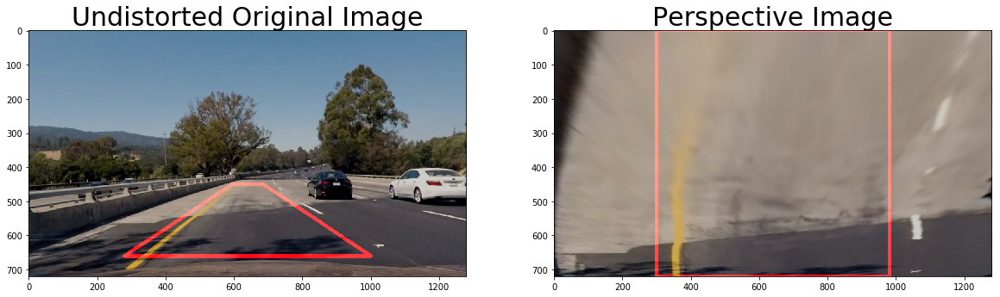

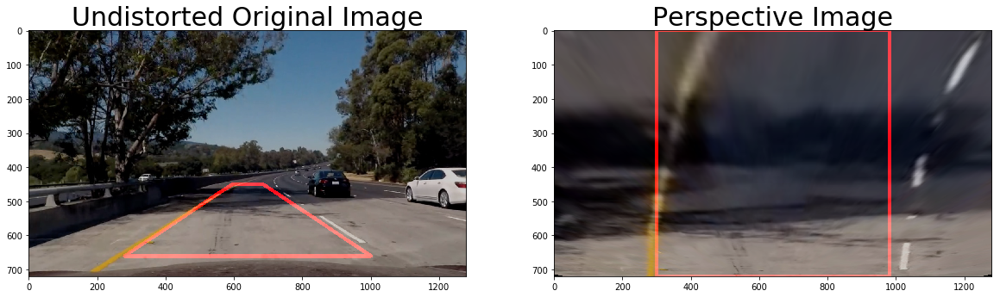

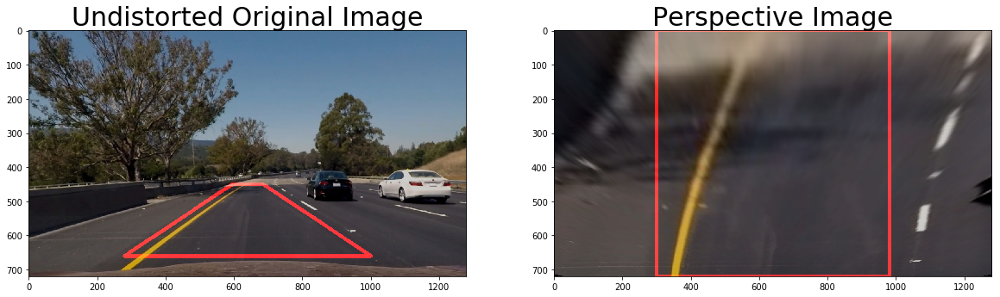

In [8]:
outfile = 'output_images/perspective/perspective_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist, show_lines=True)
    perspective = l.get_perspective(mtx, dist, show_lines=True, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(undistorted, 'Undistorted Original Image', perspective, 'Perspective Image')

### Display the binary perspective images

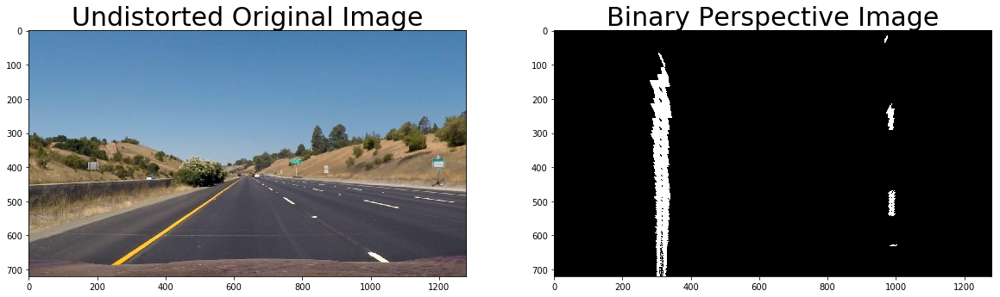

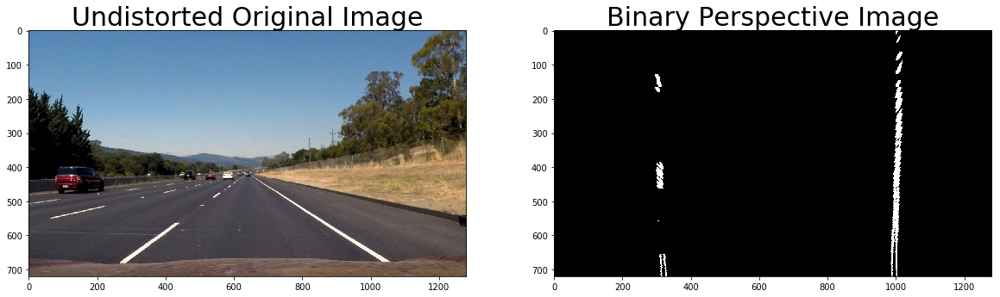

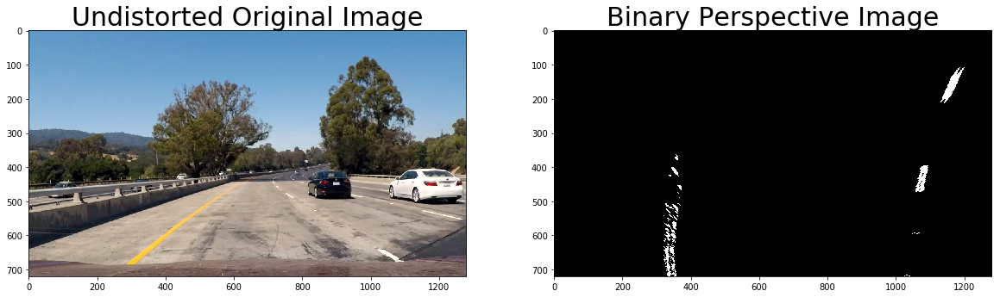

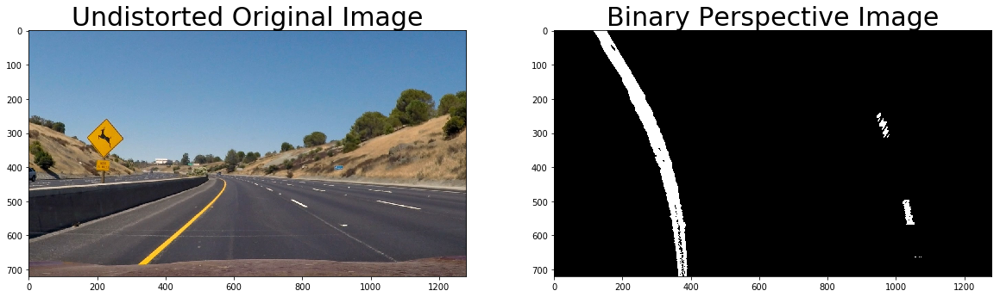

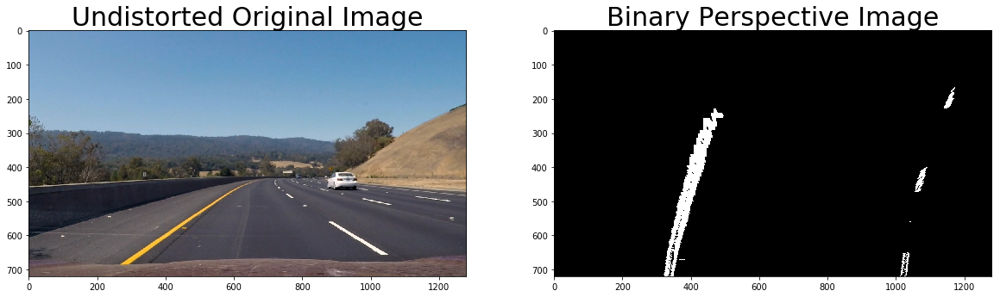

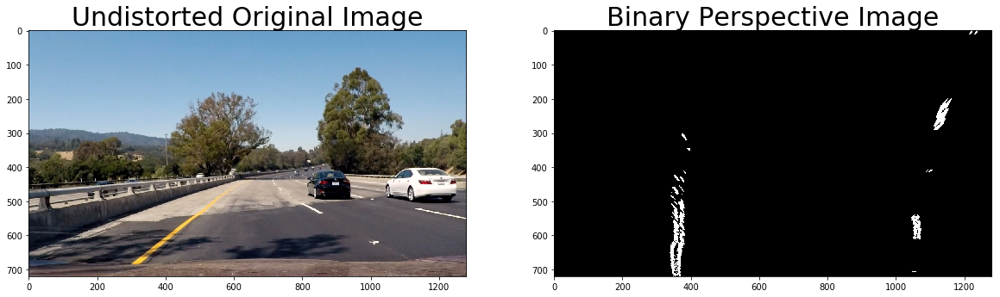

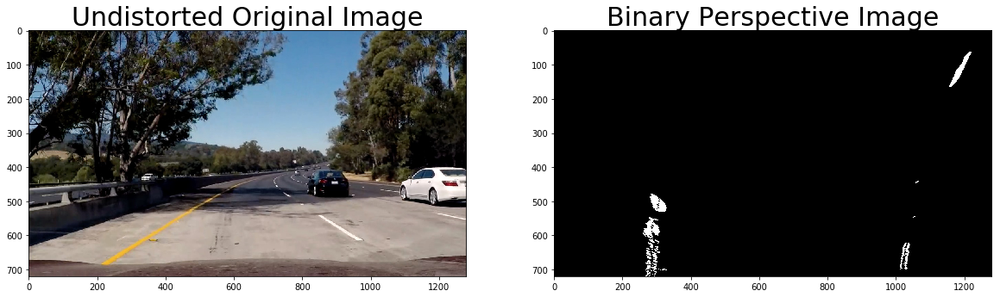

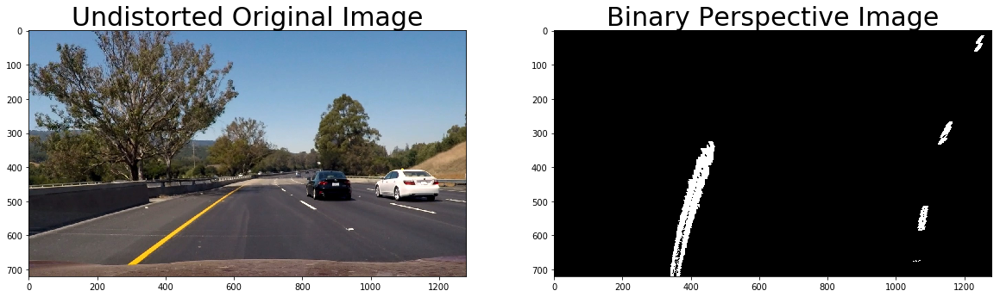

In [9]:
outfile = 'output_images/binary_perspective/binary_perspective_{0}'
for l in lanes_list:
    undistorted = l.get_undistorted(mtx, dist)
    binary_perspective = l.get_binary_perspective(mtx, dist, outfile=outfile.format(os.path.basename(l.imgpath)))
    image.show_images(l.img, 'Undistorted Original Image', binary_perspective*255, 'Binary Perspective Image')

## 5. Detect lane pixels and fit to find the lane boundary.

### Find the lane lines using moving windows

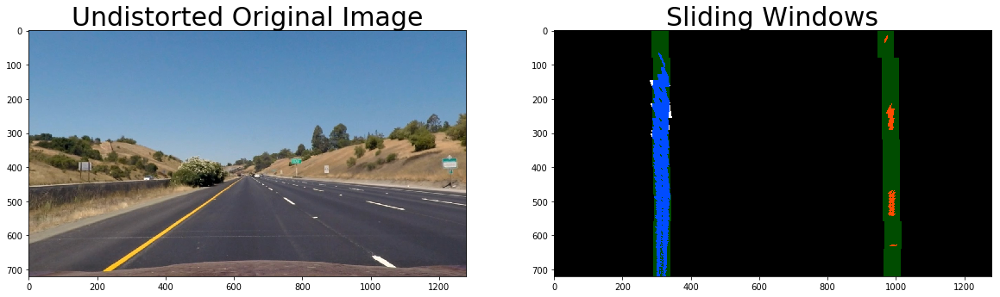

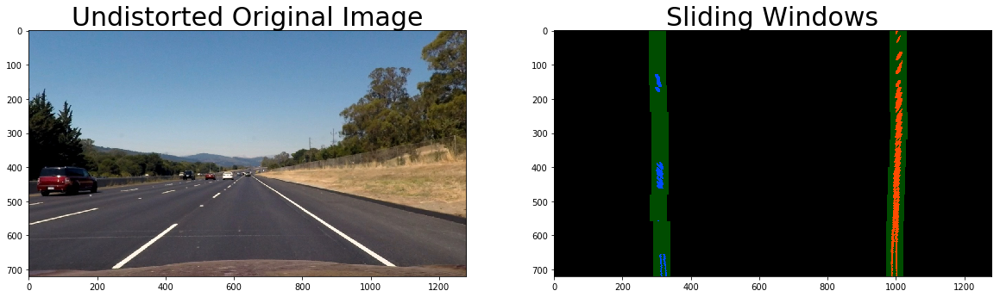

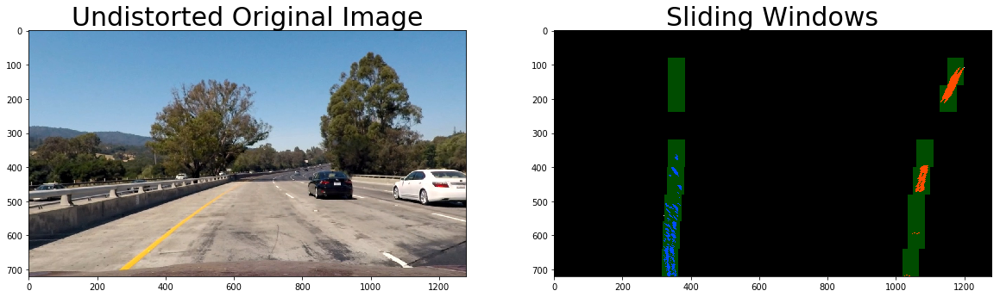

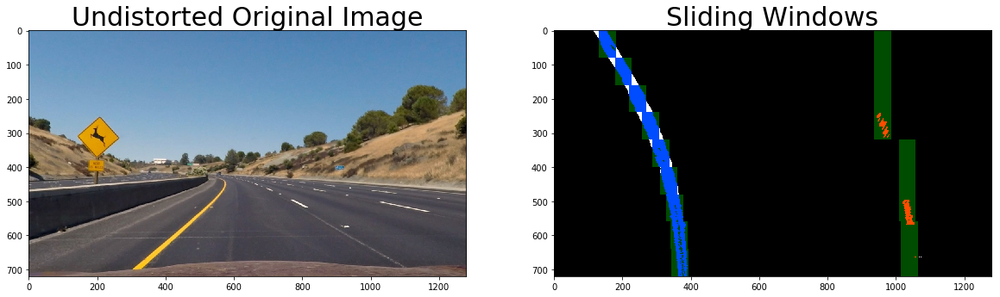

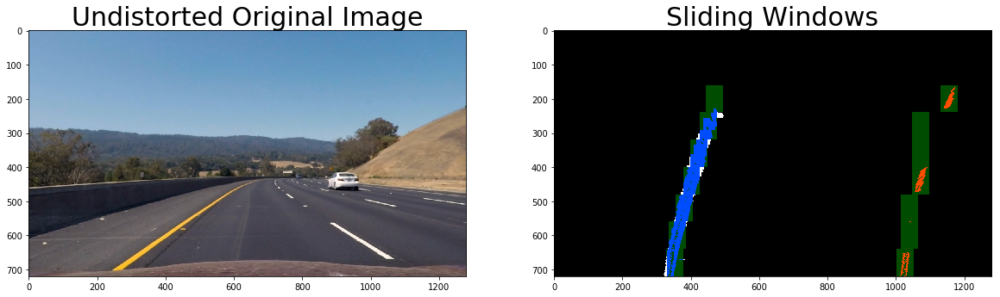

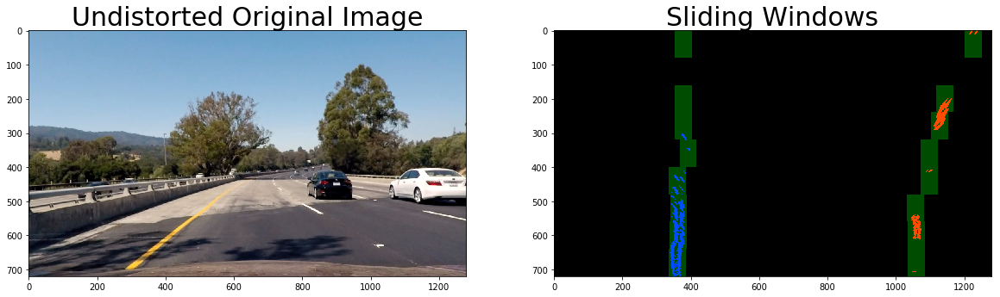

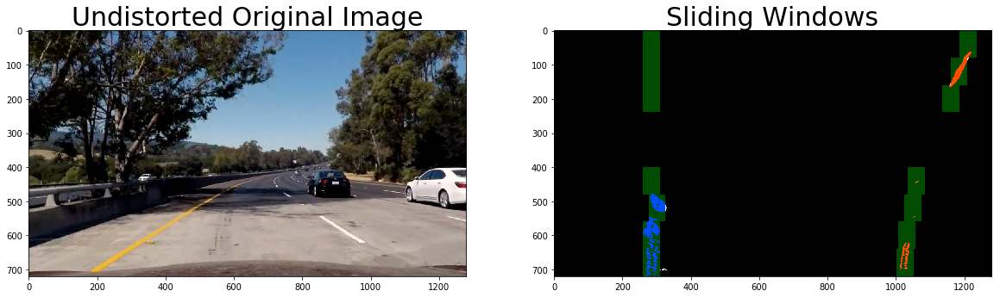

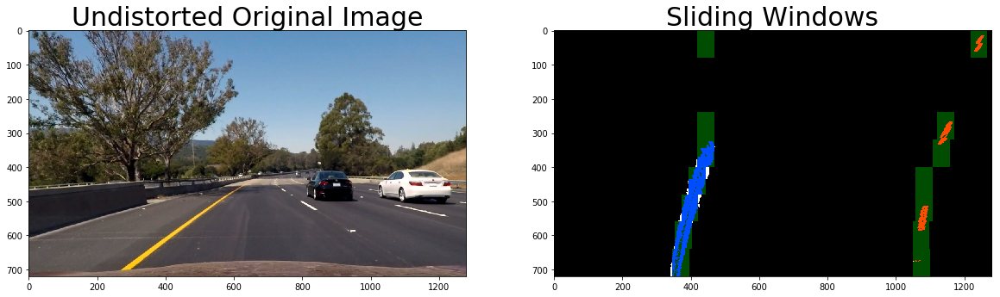

In [11]:
outfile = 'output_images/windows/windows_{0}'
for l in lanes_list:
    window_centroids = l.find_window_centroids(mtx, dist, window_width, window_height, margin_naive, minsum)
    l.plot_window_centroids(mtx, dist, window_centroids, window_width, window_height,
                            outfile=outfile.format(os.path.basename(l.imgpath)))

### Fit the lines and plot the results on the binary perspective images

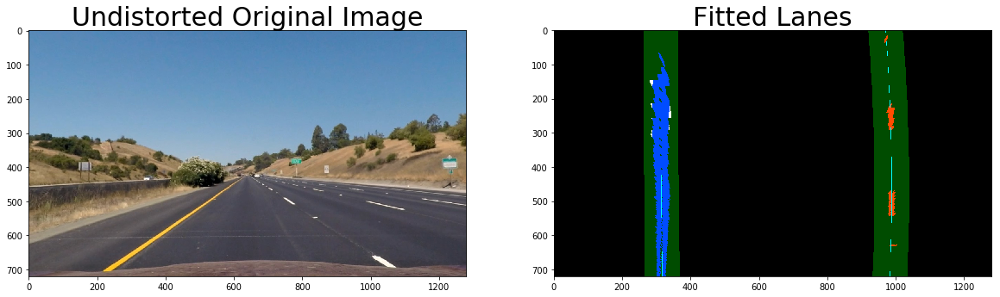

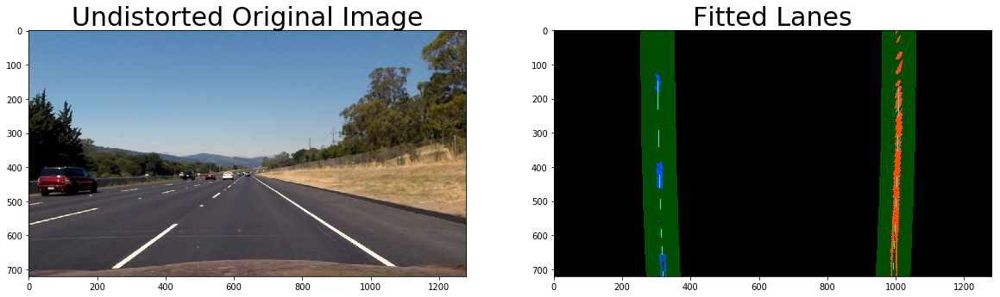

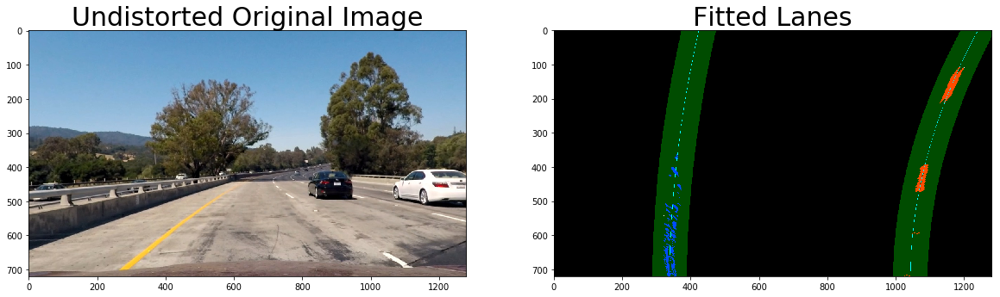

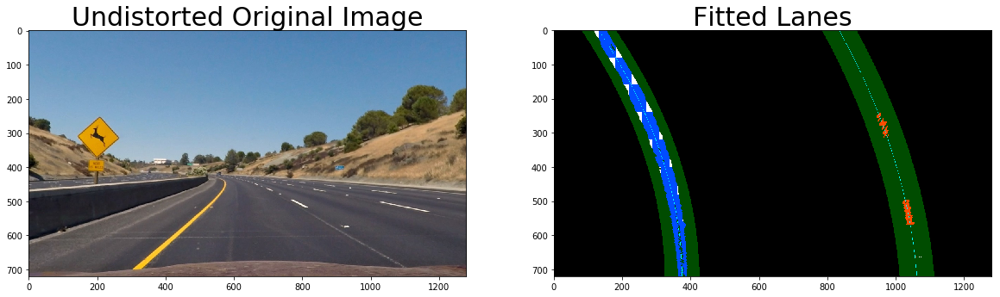

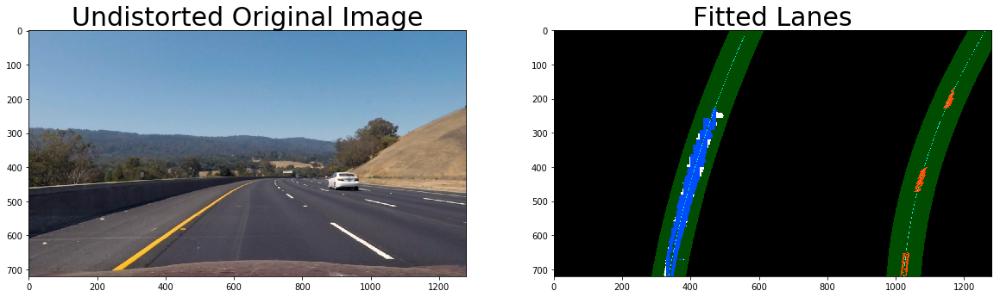

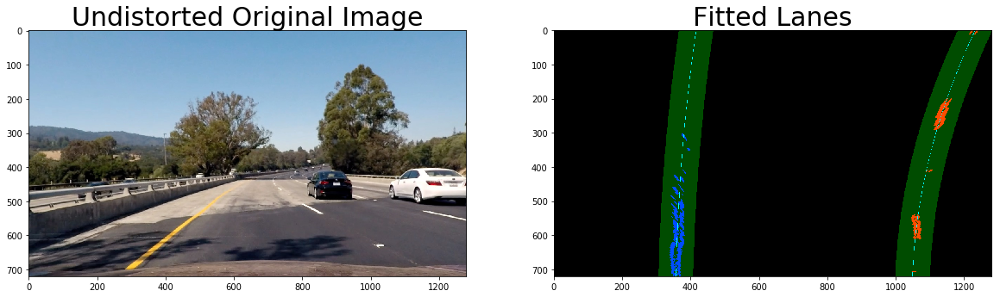

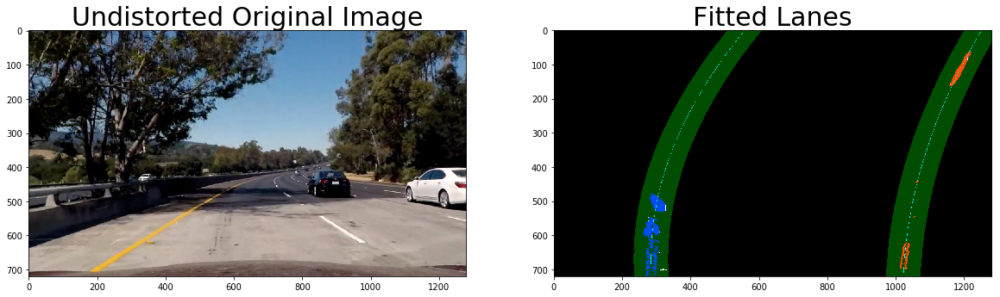

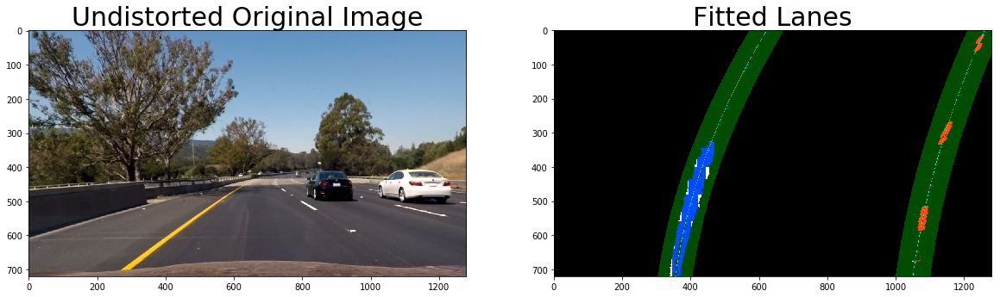

In [12]:
outfile = 'output_images/lines_perspective/lines_perspective_{0}'
for l in lanes_list:
    l.fit_lines(mtx, dist, margin_naive, margin_prior, window_width, window_height, minsum, d=2)
    l.plot_lines_perspective(mtx, dist, margin_naive, outfile=outfile.format(os.path.basename(l.imgpath)))

## 6. Determine the curvature of the lane and vehicle position with respect to center.

See Section 8.

## 7. Warp the detected lane boundaries back onto the original image.

See Section 8.

## 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

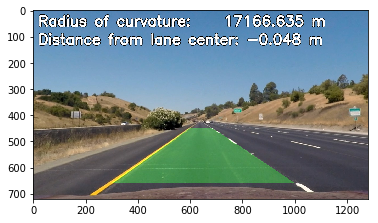

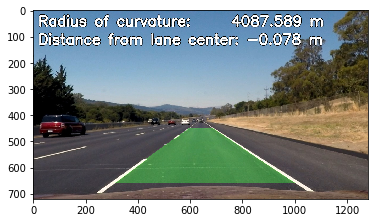

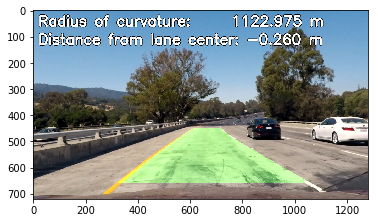

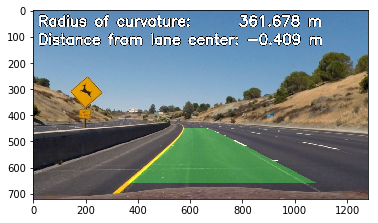

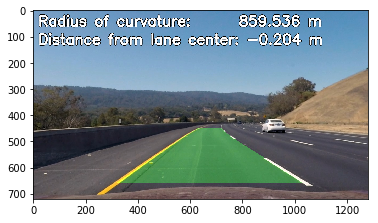

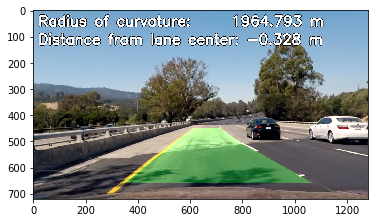

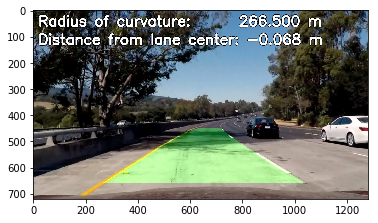

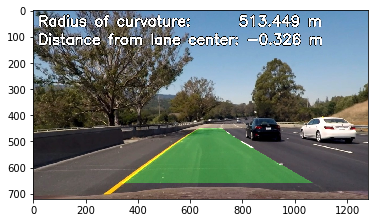

In [13]:
outfile = 'output_images/lines/lines_{0}'
for l in lanes_list:
    l.plot_lines(mtx, dist, show_plot=True, outfile=outfile.format(os.path.basename(l.imgpath)))

## Processing a Video

### Load the frames

In [14]:
clip = 'project_video.mp4'

# use the previous `n` frames to help detect the lane
n = 3


vidcap = cv2.VideoCapture(clip)
count = 0
lanes_list = []
success = True

while success:
    success, img = vidcap.read()
    
    if success:    
        l = lane.Lane(img)
        if count > 0:
            l.prev = lanes_list[max(count-n, 0):count][::-1]

        lanes_list.append(l)
        
    if cv2.waitKey(10) == 27:                     # exit if Escape is hit
        break
    count += 1

### Fit the lane lines

In [15]:
for l in lanes_list:
    l.fit_lines(mtx, dist, margin_naive, margin_prior, window_width, window_height, minsum, d=2)

### Output a video

In [16]:
output = 'project_video_lanes.mp4'

clip = ImageSequenceClip([l.plot_lines(mtx, dist)[:, :, ::-1] for l in lanes_list], fps=30)
clip.write_videofile(output)

Moviepy - Building video project_video_lanes.mp4.
Moviepy - Writing video project_video_lanes.mp4



Moviepy - Done !
Moviepy - video ready project_video_lanes.mp4
